# Mount the drive

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Importing libraries

In [2]:
import pandas as pd
import requests
import numpy as np
from scipy import io as spio
import matplotlib.colors as mcolors
import os
import cv2
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sn
from google.colab import files
from scipy.io import loadmat
import io
from PIL import Image
import joblib
import tensorflow as tf
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
# import wfdb
from sklearn.metrics import confusion_matrix
import seaborn as sns
import ast
from keras import regularizers
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import roc_auc_score
from sklearn import metrics
from sklearn.tree import DecisionTreeClassifier
from imblearn.under_sampling import RandomUnderSampler, TomekLinks 
from imblearn.over_sampling import RandomOverSampler, SMOTE
from keras import layers
from keras.models import Model
from keras.layers import Input
from keras.layers import Conv2D, BatchNormalization, Flatten, Dense, Convolution2D
from keras.layers import MaxPool2D, ZeroPadding2D, MaxPooling2D
from keras.layers import Dropout
from keras.layers.merge import concatenate
from keras.utils import plot_model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow import keras
from keras.utils import np_utils
from keras.callbacks import EarlyStopping
from keras.models import Sequential, load_model
from tensorflow.keras.optimizers import Adam,RMSprop,SGD,Adamax
from keras import regularizers
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.preprocessing.image import ImageDataGenerator
from numpy import expand_dims
import matplotlib.image as mpimg 
from skimage.color import rgb2gray
from keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg19 import VGG19

/usr/local/lib/python3.7/dist-packages/sklearn/externals/six.py:31: FutureWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", FutureWarning)
/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.neighbors.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.neighbors. Anything that cannot be imported from sklearn.neighbors is now part of the private API.
  warnings.warn(message, FutureWarning)


# 20 & 14 Classification Data

In [ ]:
poses = {9:'Excercising & cardio in a gym', 
         17:'Dancing & its different forms',
         18:'Couple dance (salsa)',
         23:'Bicycle riding',
         24:'Bicycle racing',
         43:'Carpentering',
         58:'Excercise & weight training',
         70:'Cooking',
         123:'Cutting trees (Foresting)',
         130:'Golf',
         248:'Gymming & cardio',
         252:'Climbing',
         256:'Skipping',
         257:'Gymming & back-body training',
         290:'Skating',
         300:'Skiing',
         313:'Football, playing in a field',
         314:'Baseball',
         364:'Cardio',
         396:'Stretching & Flexing'}

combine_class = {'Excercising & cardio in a gym':0, 'Excercise & weight training':0, 'Gymming & cardio':0, 'Gymming & back-body training':0,
                 'Cardio':0, 'Dancing & its different forms':1, 'Couple dance (salsa)':1, 'Bicycle riding':2, 'Bicycle racing':2, 
                 'Carpentering':3, 'Cooking':4, 'Cutting trees (Foresting)':5, 'Golf':6, 'Climbing':7, 'Skipping':8, 'Skating':9,
                 'Skiing':10, 'Football, playing in a field':11, 'Baseball':12, 'Stretching & Flexing':13}

class_labels = {0:'Excercising & cardio', 1:'Dancing', 2:'Bicycling', 3:'Carpentering', 4:'Cooking', 5:'Cutting trees (Foresting)',
                6:'Golf', 7:'Climbing', 8:'Skipping', 9:'Skating', 10:'Skiing', 11:'Football', 12:'Baseball', 13:'Stretching & Flexing'}

In [ ]:
X_train = joblib.load("/content/drive/MyDrive/DL/DL_Project_Data/TrainData_Classification_20")
X_test = joblib.load("/content/drive/MyDrive/DL/DL_Project_Data/TestData_Classification_20")
y_train = joblib.load("/content/drive/MyDrive/DL/DL_Project_Data/TrainData_Classification_20_labels")
y_test = joblib.load("/content/drive/MyDrive/DL/DL_Project_Data/TestData_Classification_20_labels")

In [ ]:
for i in range(len(y_train)): # Combining common labels for 14 classes
  y_train[i] = combine_class[y_train[i]]
for i in range(len(y_test)):
  y_test[i] = combine_class[y_test[i]]

In [ ]:
le = LabelEncoder()
y_train = le.fit_transform(y_train)
y_test = le.transform(y_test)

In [ ]:
class_labels = le.classes_ # for 20 classes
print(class_labels)
print(len(class_labels))

['Baseball' 'Bicycle racing' 'Bicycle riding' 'Cardio' 'Carpentering'
 'Climbing' 'Cooking' 'Couple dance (salsa)' 'Cutting trees (Foresting)'
 'Dancing & its different forms' 'Excercise & weight training'
 'Excercising & cardio in a gym' 'Football, playing in a field' 'Golf'
 'Gymming & back-body training' 'Gymming & cardio' 'Skating' 'Skiing'
 'Skipping' 'Stretching & Flexing']
20


In [ ]:
def shuffling(X, y):
  data = pd.DataFrame(X.reshape(X.shape[0], X.shape[1]*X.shape[2]*X.shape[3]))
  data['label'] = y
  data = data.sample(frac=1, random_state=42)
  X = data.iloc[:, :-1].values.reshape(X.shape[0], X.shape[1], X.shape[2], X.shape[3])
  y = data.iloc[:, -1].values
  return X, y

In [ ]:
X_train1, y_train1 = shuffling(np.array(X_train), y_train)

In [ ]:
X_test, y_test = shuffling(np.array(X_test), y_test)

In [ ]:
num_classes = np.unique(y_train1).shape[0]
y_train11 = np_utils.to_categorical(y_train1, num_classes)
y_test1 = np_utils.to_categorical(y_test, num_classes)

# Augmented data 

In [ ]:
img_size = 224
train_datagen = ImageDataGenerator(rescale = 1./255)

In [ ]:
train_generator = train_datagen.flow_from_directory(directory = '/content/drive/MyDrive/DL/train1',
                                                    target_size = (img_size,img_size),
                                                    batch_size=30, 
                                                    class_mode="sparse",
                                                    subset = "training")

Found 2360 images belonging to 20 classes.


In [ ]:
validation_datagen = ImageDataGenerator(rescale = 1./255, validation_split = .9999)

In [ ]:
validation_generator = validation_datagen.flow_from_directory(directory = '/content/drive/MyDrive/DL/test_1',
                                                              target_size = (img_size,img_size),
                                                              batch_size=30, class_mode="sparse",
                                                              subset = "validation")

Found 828 images belonging to 20 classes.


In [ ]:
validation_generator1 = validation_datagen.flow_from_directory(directory = '/content/drive/MyDrive/DL/test_1',
                                                              target_size = (img_size,img_size),
                                                              batch_size=30, class_mode="sparse",shuffle=False,
                                                              subset = "validation")

Found 828 images belonging to 20 classes.


In [ ]:
train_generator50 = train_datagen.flow_from_directory(directory = '/content/drive/MyDrive/DL/train50',
                                                    target_size = (img_size,img_size),
                                                    batch_size=30, 
                                                    class_mode="sparse",
                                                    subset = "training")

Found 3270 images belonging to 50 classes.


In [ ]:
validation_generator50 = validation_datagen.flow_from_directory(directory = '/content/drive/MyDrive/DL/test50',
                                                              target_size = (img_size,img_size),
                                                              batch_size=30, class_mode="sparse",
                                                              subset = "validation")

Found 1070 images belonging to 50 classes.


In [ ]:
validation_generator50_1 = validation_datagen.flow_from_directory(directory = '/content/drive/MyDrive/DL/test50',
                                                              target_size = (img_size,img_size),
                                                              batch_size=30, class_mode="sparse",shuffle=False,
                                                              subset = "validation")

Found 1070 images belonging to 50 classes.


# 50 Classes Data

In [3]:
X_train = joblib.load('/content/drive/MyDrive/DL/DL_Project_Data/Regression_train_50')
y_train = joblib.load('/content/drive/MyDrive/DL/DL_Project_Data/Regression_train_IDS_50')
X_test = joblib.load('/content/drive/MyDrive/DL/DL_Project_Data/Regression_test_50')
y_test = joblib.load('/content/drive/MyDrive/DL/DL_Project_Data/Regression_test_IDS_50')

In [4]:
data = pd.read_csv('/content/drive/MyDrive/DL/mpii_dataset.csv')
data

,Unnamed: 0,NAME,r ankle_X,r ankle_Y,r knee_X,r knee_Y,r hip_X,r hip_Y,l hip_X,l hip_Y,l knee_X,l knee_Y,l ankle_X,l ankle_Y,pelvis_X,pelvis_Y,thorax_X,thorax_Y,upper neck_X,upper neck_Y,head top_X,head top_Y,r wrist_X,r wrist_Y,r elbow_X,r elbow_Y,r shoulder_X,r shoulder_Y,l shoulder_X,l shoulder_Y,l elbow_X,l elbow_Y,l wrist_X,l wrist_Y,Scale,Activity,Category
0,0,015601864.jpg,620,394,616,269,573,185,647,188,661,221,656,231,610,187,647,176,637.0201,189.8183,695.9799,108.1817,606,217,553,161,601,167,692,185,693,240,688,313,3.021046,curling,sports
1,0,015599452.jpg,-1,-1,-1,-1,806,543,720,593,-1,-1,-1,-1,763,568,683,290,682.0000,256.0000,676.0000,68.0000,563,296,555,410,647,281,719,299,711,516,545,466,5.641276,curling,sports
2,0,005808361.jpg,804,711,816,510,908,438,1040,454,906,528,883,707,974,446,985,253,982.7591,235.9694,962.2409,80.0306,869,214,798,340,902,253,1067,253,1167,353,1142,478,4.718488,curling,sports
3,0,086617615.jpg,301,461,305,375,201,340,294,342,335,370,331,455,248,341,279,263,277.0210,268.7786,305.9790,184.2214,328,354,260,335,244,261,314,264,327,320,362,346,2.681349,curling,sports
4,0,060111501.jpg,980,322,896,318,865,248,943,226,948,290,881,349,904,237,858,135,871.1877,180.4244,835.8123,58.5756,772,294,754,247,792,147,923,123,995,163,961,223,3.806403,curling,sports
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17367,0,033474347.jpg,876,461,815,380,779,296,742,303,706,386,739,468,761,300,684,219,671.7848,204.2324,629.2152,152.7676,693,243,726,260,704,214,663,223,674,286,631,260,2.003677,pushing car,transportation
17368,0,082650067.jpg,1038,656,950,504,903,328,831,337,811,504,853,637,867,333,775,212,762.9653,196.7913,696.0347,112.2087,815,236,864,273,821,204,729,220,704,332,675,269,3.235820,pushing car,transportation
17369,0,072772110.jpg,562,617,558,539,553,452,511,458,529,536,541,610,532,455,531,378,528.9869,352.8365,525.0131,303.1635,558,411,565,393,572,377,490,378,470,411,461,414,1.494952,pushing car,transportation
17370,0,039361034.jpg,496,377,466,322,510,278,540,280,558,331,596,368,525,279,454,252,451.3169,251.4431,403.6831,241.5569,378,311,404,288,441,253,466,251,436,293,410,325,1.459468,pushing car,transportation


In [ ]:
image_name = data.iloc[:, 1].values
image_lbl = data.iloc[:, -2].values
image_cat = data.iloc[:, -1].values

In [ ]:
def take_Labels_Categories(y):
  y1 = []
  for i in range(len(y)):
    for j in range(len(image_name)):
      if y[i] == image_name[j]:
        # y1.append((image_lbl[j], image_cat[j]))
        y1.append(image_lbl[j])
        break
  return np.array(y1)

In [ ]:
y_train1 = take_Labels_Categories(y_train)

In [ ]:
y_test1 = take_Labels_Categories(y_test)

cooking or food preparation


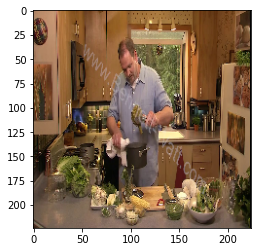

In [ ]:
plt.imshow(X_test[110])
print(y_test1[110])

In [ ]:
le = LabelEncoder()
y_train = le.fit_transform(y_train1)
y_test = le.transform(y_test1)

In [ ]:
class_labels = le.classes_

In [ ]:
class_labels

array(['aerobic, step', 'backpacking', 'ballroom', 'bicycling, mountain',
       'bicycling, racing and road', 'bicycling, stationary',
       'calisthenics', 'canoeing, kayaking, rowing, competitive',
       'carpentry, finishing or refinishing cabinets or furniture',
       'carpentry, general', 'carpentry, sawing hardwood',
       'chopping wood', 'circuit training', 'clearing brush',
       'cooking or food preparation',
       'digging, spading, filling garden, composting', 'eating, sitting',
       'ethnic or cultural dancing (e.g., Greek, Middle Eastern, hula, salsa, merengue, bamba y plena, flame',
       'fishing from river bank',
       'fishing in stream, in waders (Taylor Code 670)',
       'fishing, general', 'forestry', 'ironing',
       'manual or unskilled labor', 'martial arts, different types',
       'masonry, concrete', 'paddleball', 'pilates, general',
       'planting, potting, transplanting seedlings or plants, light effort',
       'playing with children', 'resi

In [ ]:
num_classes = np.unique(y_train1).shape[0]
y_train11 = np_utils.to_categorical(y_train, num_classes)
y_test11 = np_utils.to_categorical(y_test, num_classes)

## Creating Labels For Regression

In [5]:
data1 = data.iloc[:,:].values

In [6]:
cl1 = data1[:, 1]
cl2 = data1[:, -2]

In [7]:
data1 = data1[:, 2:-3]

In [8]:
def create_labels(y_train):
  y = []
  for j in range(len(y_train)):
    for i in range(len(cl1)):
      if y_train[j] == cl1[i]:
        y.append(data1[i])
        break
  return np.array(y)

In [9]:
y_train1 = create_labels(y_train)
y_test1 = create_labels(y_test)

In [10]:
y_test1.shape, y_train1.shape

((1290, 32), (3740, 32))

In [11]:
y_test1 = y_test1.astype('float')
y_train1 = y_train1.astype('float')

# Model Results

In [ ]:
model = load_model('/content/drive/MyDrive/DL/DL_Project_Data/Human_Pose_Models/Classification_Models/resnet50_On14_Classes.h5')

In [ ]:
predictions = model.predict(X_test)
y_pred = np.argmax(predictions, axis = 1)

In [ ]:
index_good = []
index_bad = []
for i in range(len(y_test)):
  if (y_test[i] == y_pred[i]):
    index_good.append(i)
  else:
    index_bad.append(i)

In [ ]:
len(index_bad), len(index_good)

(76, 772)

### Miss-Classification results

Predicted Pose: Excercising & cardio
Actual Pose: Cooking


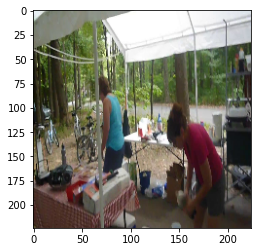

In [ ]:
indx = 2
plt.imshow(X_test[index_bad[indx]])
print('Predicted Pose:',class_labels[y_pred[index_bad[indx]]]) 
print('Actual Pose:',class_labels[y_test[index_bad[indx]]])

Predicted Pose: Excercising & cardio
Actual Pose: Bicycling


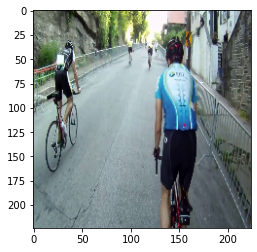

In [ ]:
indx = 140
plt.imshow(X_test[index_bad[indx]])
print('Predicted Pose:',class_labels[y_pred[index_bad[indx]]]) 
print('Actual Pose:',class_labels[y_test[index_bad[indx]]])

Predicted Pose: skiing, downhill
Actual Pose: fishing, general


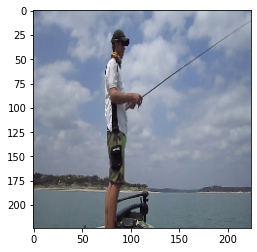

In [ ]:
indx = 16
plt.imshow(X_test[index_bad[indx]])
print('Predicted Pose:',class_labels[y_pred[index_bad[indx]]]) 
print('Actual Pose:',class_labels[y_test[index_bad[indx]]])

Predicted Pose: rollerblading
Actual Pose: soccer


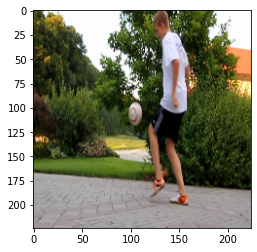

In [ ]:
indx = 50
plt.imshow(X_test[index_bad[indx]])
print('Predicted Pose:',class_labels[y_pred[index_bad[indx]]]) 
print('Actual Pose:',class_labels[y_test[index_bad[indx]]])

### Correct-Classification results

Predicted Pose: Baseball
Actual Pose: Baseball


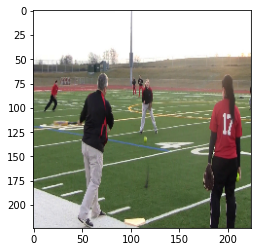

In [ ]:
indx = 2
plt.imshow(X_test[index_good[indx]])
print('Predicted Pose:',class_labels[y_pred[index_good[indx]]]) 
print('Actual Pose:',class_labels[y_test[index_good[indx]]])

Predicted Pose: Gymming & back-body training
Actual Pose: Gymming & back-body training


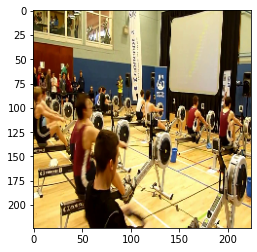

In [ ]:
indx = 140
plt.imshow(X_test[index_good[indx]])
print('Predicted Pose:',class_labels[y_pred[index_good[indx]]]) 
print('Actual Pose:',class_labels[y_test[index_good[indx]]])

Predicted Pose: Bicycling
Actual Pose: Bicycling


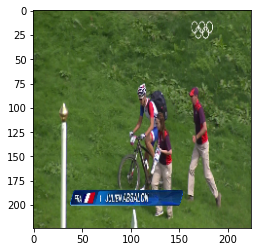

In [ ]:
indx = 200
plt.imshow(X_test[index_good[indx]])
print('Predicted Pose:',class_labels[y_pred[index_good[indx]]]) 
print('Actual Pose:',class_labels[y_test[index_good[indx]]])

Predicted Pose: skating, ice dancing
Actual Pose: skating, ice dancing


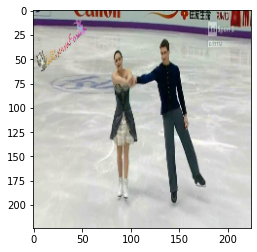

In [ ]:
indx = 500
plt.imshow(X_test[index_good[indx]])
print('Predicted Pose:',class_labels[y_pred[index_good[indx]]]) 
print('Actual Pose:',class_labels[y_test[index_good[indx]]])

### On Random Images

In [ ]:
# url = 'https://cdni0.trtworld.com/w960/h540/q75/31524_PRT180417PolandBialowiezaForestAFP_1523966626524.jpg'
# url = 'https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcR7M2LNu-GgW-FGWGd1qfFQF3iWADp9i_Aw7g&usqp=CAU'
# url = 'https://imgk.timesnownews.com/story/skipping-rope-new.gif?tr=w-1200,h-900'

In [ ]:
url = 'https://upload.wikimedia.org/wikipedia/commons/2/2d/2018_Skate_Canada_-_Evelyn_Walsh_%26_Trennt_Michaud_-_12.jpg'

In [ ]:
# url = 'https://scuolasciarabba.com/files/.thumbs/adventure_skiing/640x960a/adventure_skiing_153.jpg'
# url = 'https://imagevars.gulfnews.com/2020/03/18/Excercise_170ecac1afc_medium.jpg'
# url = 'https://cdn.24.co.za/files/Cms/General/d/7325/d084e41c286e48bcae4063a70662d675.png'
# url = 'https://s3.ap-southeast-1.amazonaws.com/images.deccanchronicle.com/dc-Cover-bsnudco08r3igtj44duecnr7m4-20170803070833.Medi.jpeg'
# url = 'https://hips.hearstapps.com/hmg-prod.s3.amazonaws.com/images/cycle-rider-riding-hard-along-the-beach-royalty-free-image-1616705538.?crop=0.668xw:1.00xh;0.332xw,0&resize=640:*'
# url = 'https://c8.alamy.com/comp/XDT1YJ/boy-inline-skating-outdoors-XDT1YJ.jpg'

In [ ]:
img = Image.open(requests.get(url, stream=True).raw)
print(type(img))

<class 'PIL.JpegImagePlugin.JpegImageFile'>


In [ ]:
print(img.format)
print(img.size)
print(img.mode)

JPEG
(400, 600)
RGB


In [ ]:
img1 = np.array(img)
img1 = cv2.resize(img1, (224, 224))
img1 = np.array(img1, ndmin=4)

Predicted Pose: Dancing


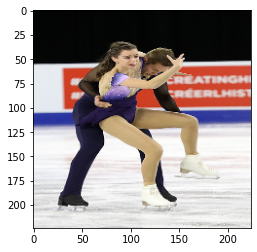

In [ ]:
predictions = model_vgg19_1.predict(img1)
y_pred = np.argmax(predictions, axis = 1)
plt.imshow(img1[0])
print('Predicted Pose:',class_labels[y_pred[0]]) 

### Xception

In [ ]:
XModel = load_model('/content/drive/MyDrive/DL/DL_Project_Data/Human_Pose_Models/Classification_Models/Xception_On20_Classes.h5')

In [ ]:
pred=XModel.predict_generator(validation_generator1)
predicted_class_indices=np.argmax(pred,axis=1)
labels = (validation_generator1.class_indices)
labels = dict((v,k) for k,v in labels.items())
predictions = [labels[k] for k in predicted_class_indices]
plabel=[]
for i in predictions:
  for m,n in poses.items():
    m=str(m)
    if m==i:
      plabel.append(n)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1905: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  warnings.warn('`Model.predict_generator` is deprecated and '


In [ ]:
y_true = validation_generator1.classes
truth = []
pred = []

for i in range(30):
    x, y = next(validation_generator1)
    pred.append(XModel.predict(x))
    truth.append(y) 

pred = np.concatenate(pred)
truth = np.concatenate(truth)
predicted_class=np.argmax(pred,axis=1)

Cutting trees (Foresting)


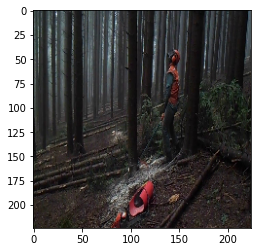

Cutting trees (Foresting)


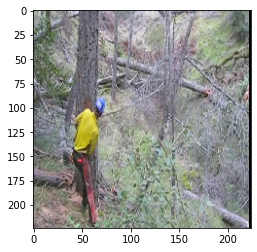

Cutting trees (Foresting)


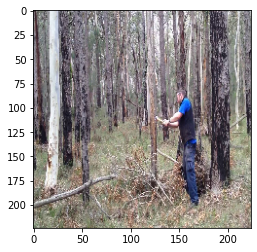

Cutting trees (Foresting)


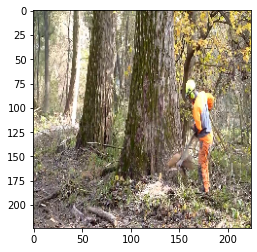

Cutting trees (Foresting)


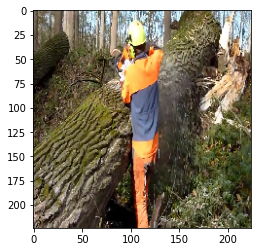

Cutting trees (Foresting)


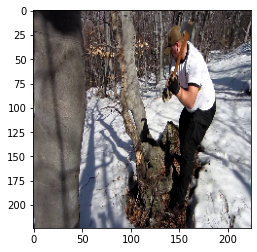

Cutting trees (Foresting)


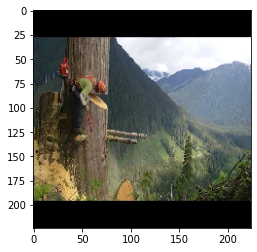

Cutting trees (Foresting)


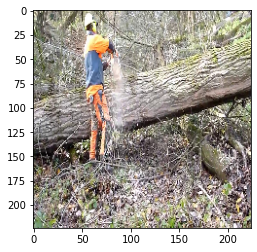

Cutting trees (Foresting)


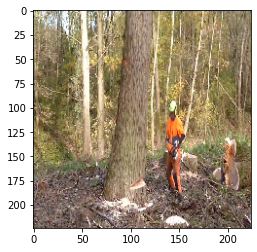

Cutting trees (Foresting)


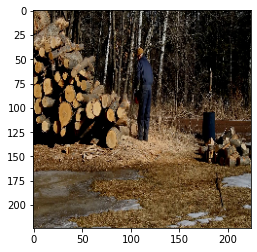

Cutting trees (Foresting)


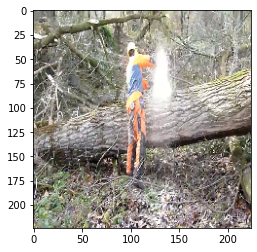

Cutting trees (Foresting)


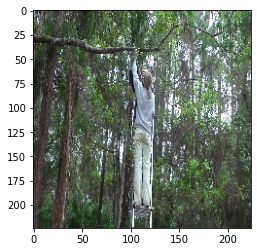

Cutting trees (Foresting)


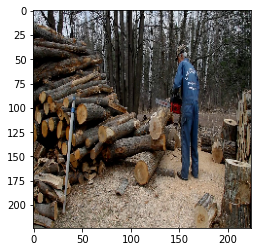

Cutting trees (Foresting)


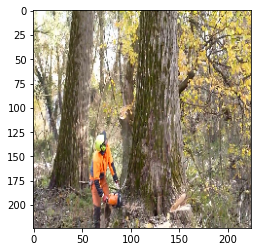

Cutting trees (Foresting)


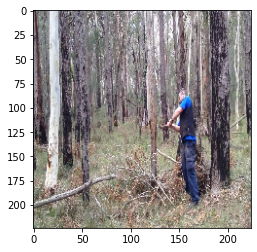

Cutting trees (Foresting)


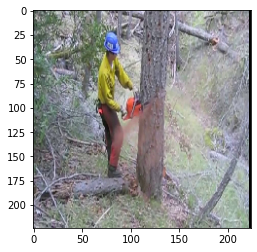

Cutting trees (Foresting)


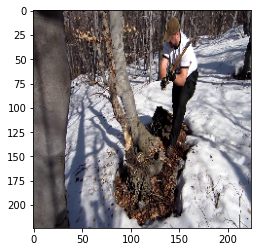

Cutting trees (Foresting)


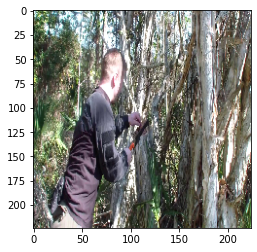

Cutting trees (Foresting)


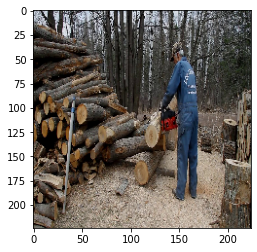

Cutting trees (Foresting)


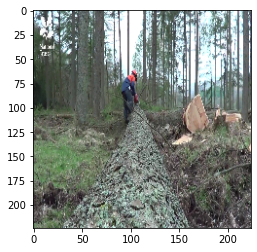

Cutting trees (Foresting)


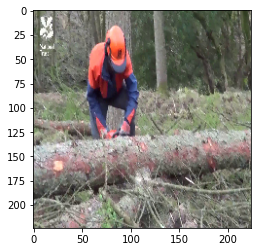

Cutting trees (Foresting)


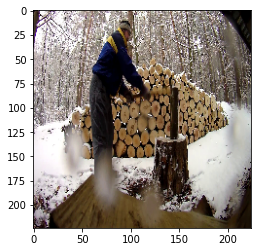

Cutting trees (Foresting)


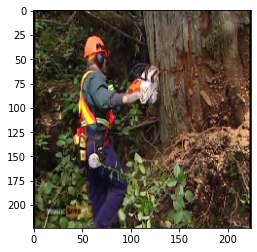

Cutting trees (Foresting)


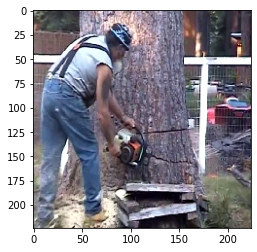

Cutting trees (Foresting)


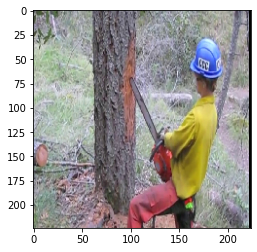

Cutting trees (Foresting)


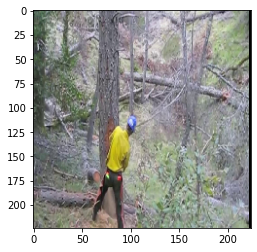

Cutting trees (Foresting)


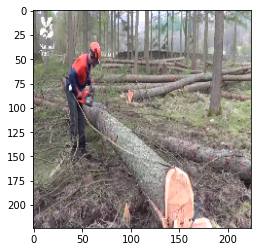

Cutting trees (Foresting)


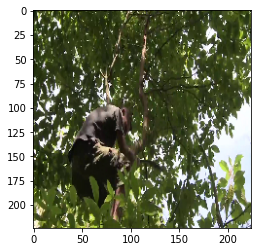

Bicycle riding


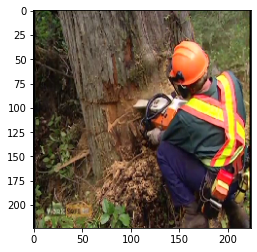

Cutting trees (Foresting)


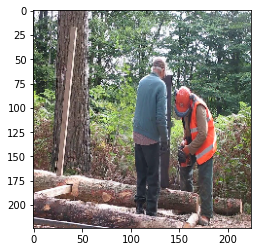

Cutting trees (Foresting)


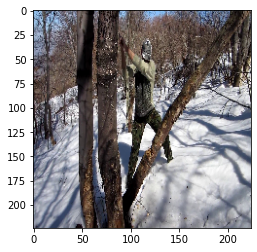

Cutting trees (Foresting)


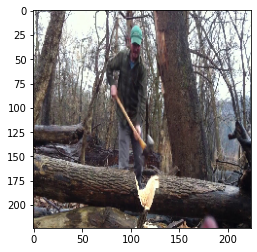

Cutting trees (Foresting)


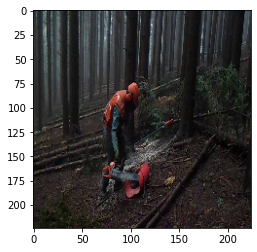

Cutting trees (Foresting)


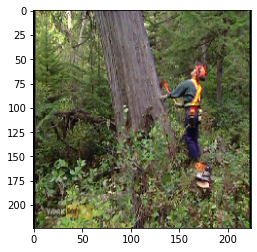

Cutting trees (Foresting)


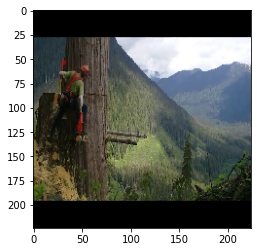

Cutting trees (Foresting)


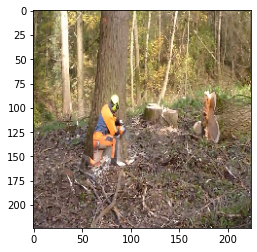

Cutting trees (Foresting)


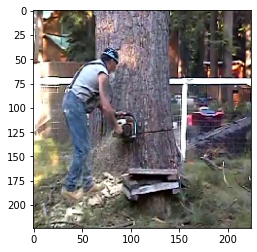

Cutting trees (Foresting)


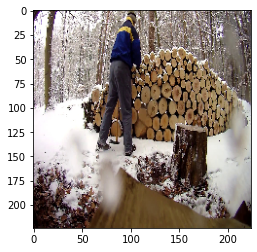

Cutting trees (Foresting)


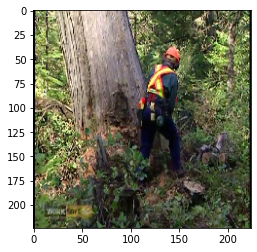

Golf


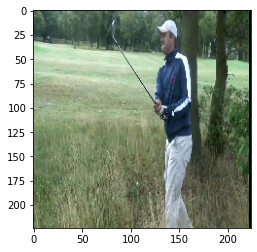

Golf


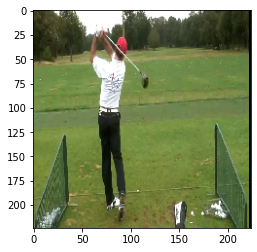

Golf


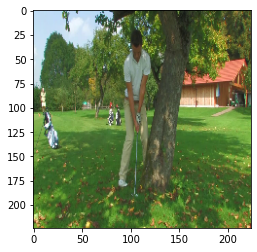

Golf


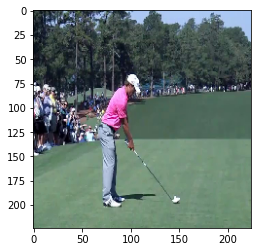

Golf


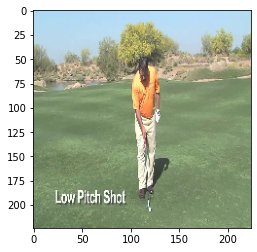

Golf


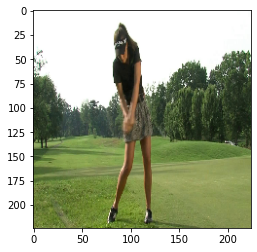

Couple dance (salsa)


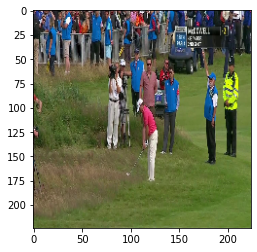

Golf


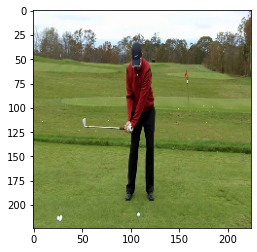

Golf


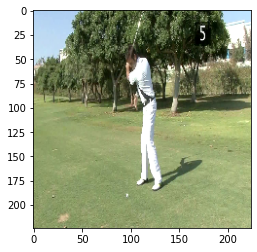

Golf


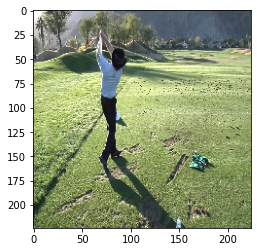

Golf


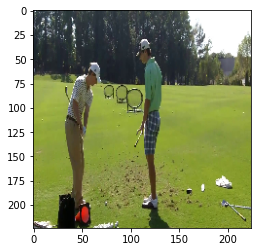

Golf


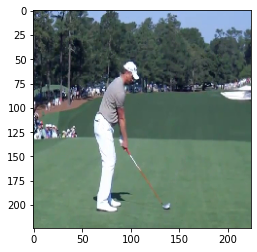

Golf


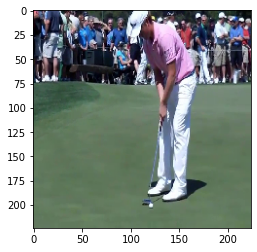

Golf


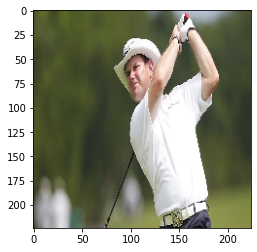

Golf


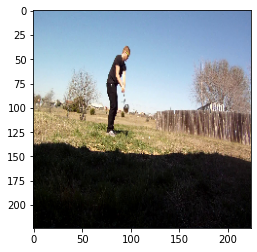

Golf


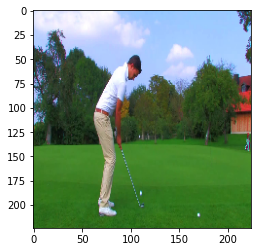

Skating


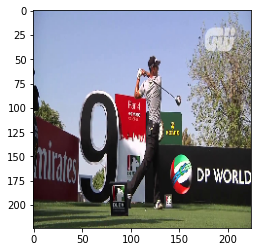

Golf


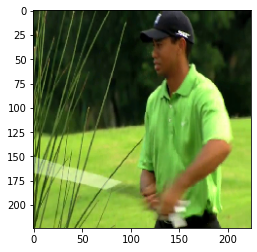

Golf


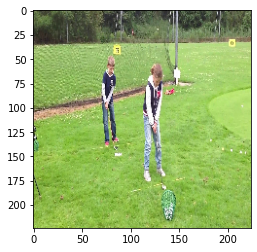

Golf


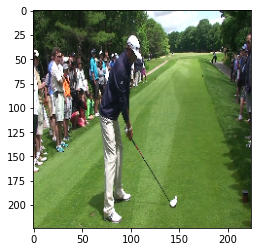

Golf


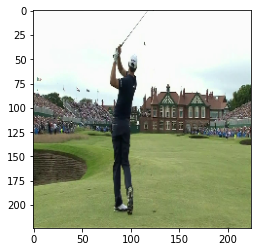

Golf


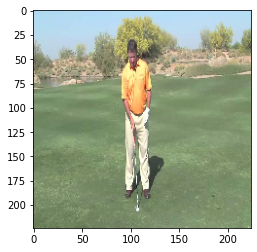

Golf


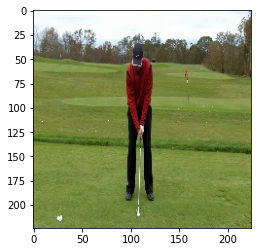

Golf


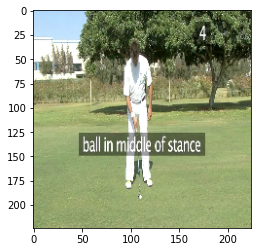

Golf


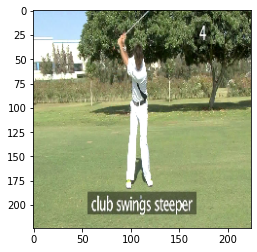

Golf


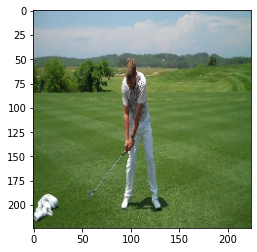

Golf


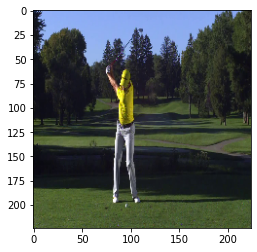

Golf


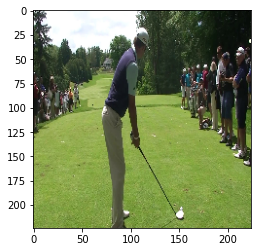

Golf


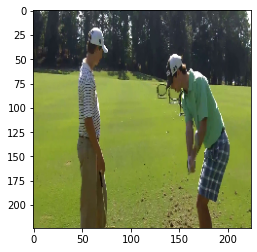

Golf


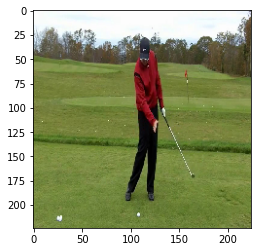

Dancing & its different forms


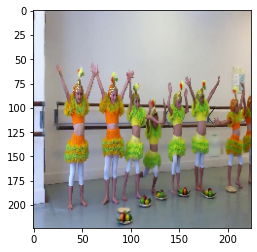

Dancing & its different forms


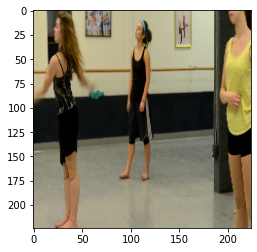

Dancing & its different forms


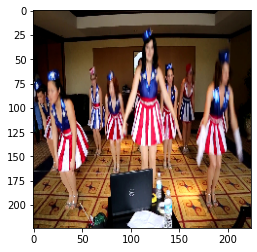

Dancing & its different forms


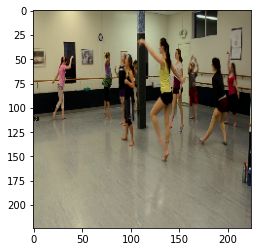

Skating


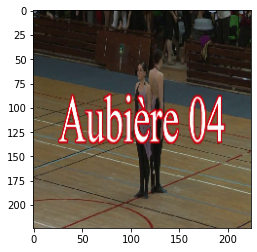

Dancing & its different forms


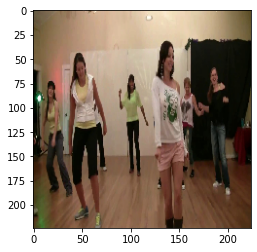

Dancing & its different forms


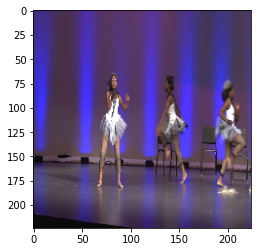

Dancing & its different forms


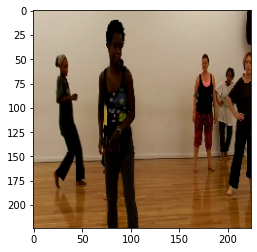

Dancing & its different forms


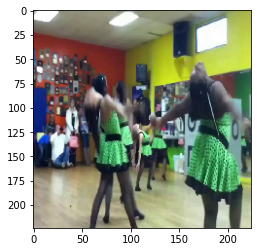

Dancing & its different forms


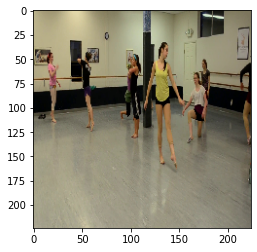

Dancing & its different forms


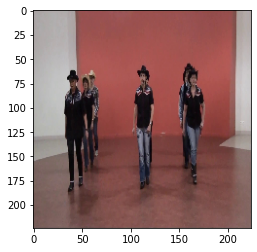

Dancing & its different forms


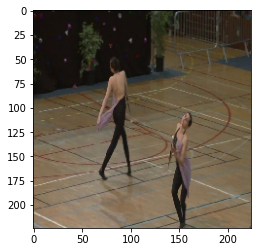

Dancing & its different forms


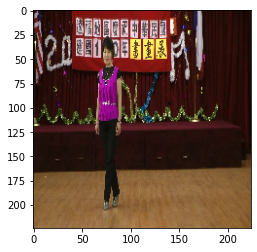

Dancing & its different forms


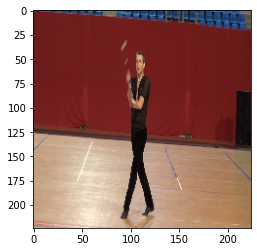

Dancing & its different forms


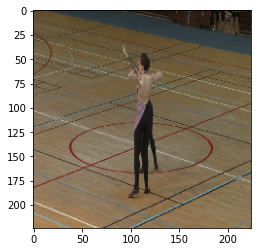

Dancing & its different forms


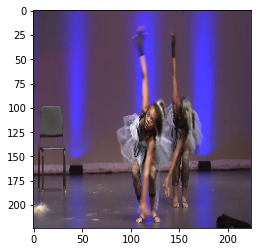

Dancing & its different forms


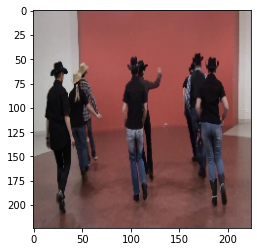

Dancing & its different forms


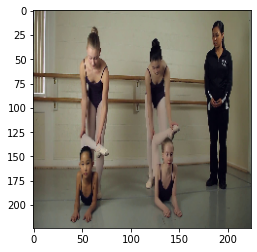

Dancing & its different forms


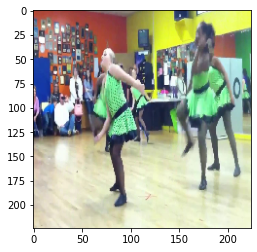

Dancing & its different forms


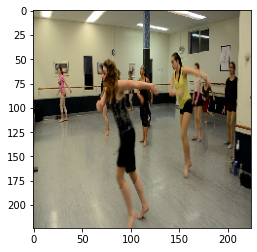

Couple dance (salsa)


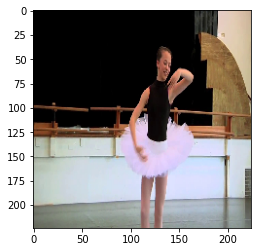

Dancing & its different forms


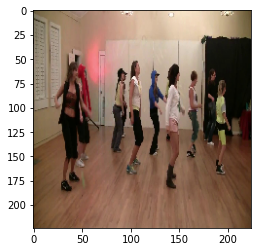

Dancing & its different forms


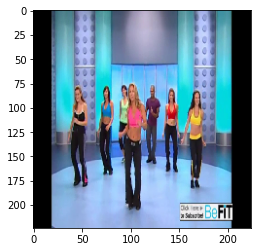

Dancing & its different forms


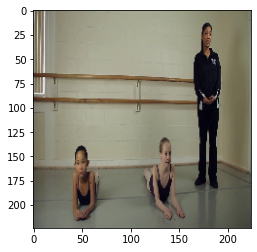

Excercise & weight training


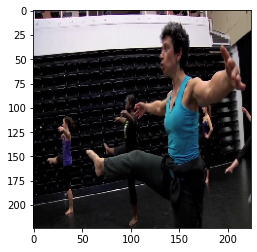

Dancing & its different forms


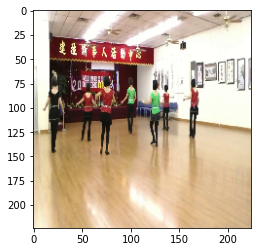

Dancing & its different forms


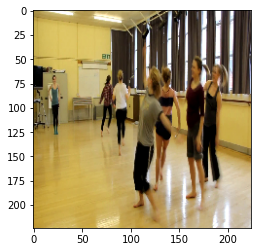

Dancing & its different forms


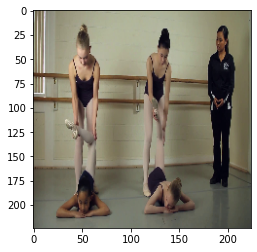

Dancing & its different forms


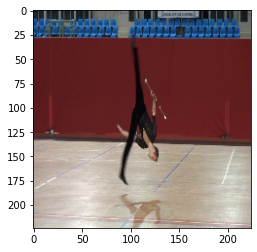

Dancing & its different forms


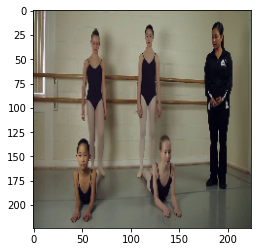

Dancing & its different forms


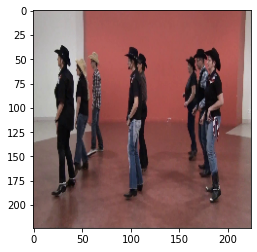

Dancing & its different forms


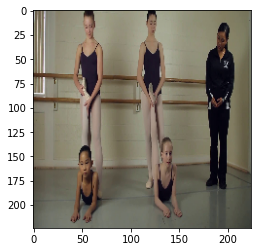

Dancing & its different forms


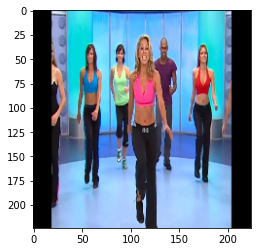

Dancing & its different forms


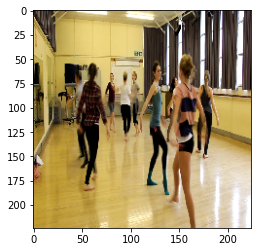

Dancing & its different forms


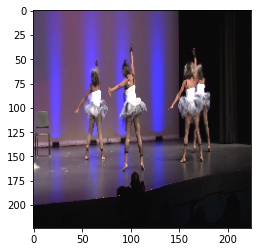

Dancing & its different forms


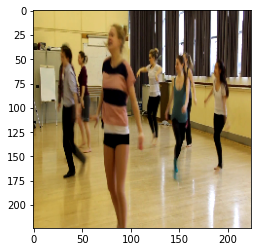

Dancing & its different forms


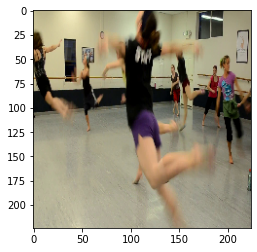

Dancing & its different forms


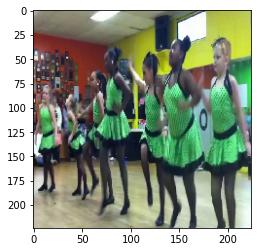

Dancing & its different forms


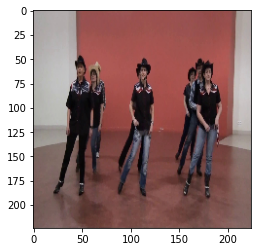

Dancing & its different forms


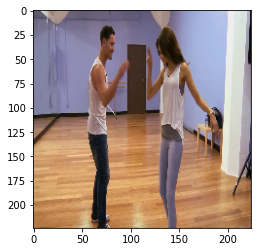

Couple dance (salsa)


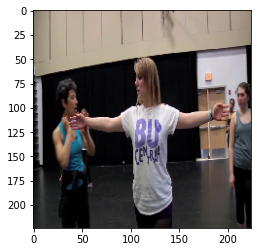

Dancing & its different forms


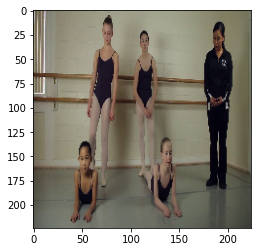

Cardio


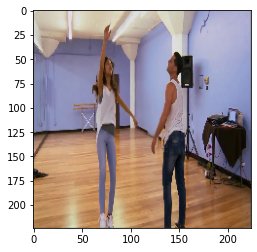

Dancing & its different forms


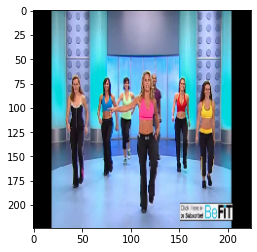

Dancing & its different forms


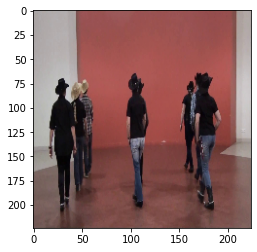

Dancing & its different forms


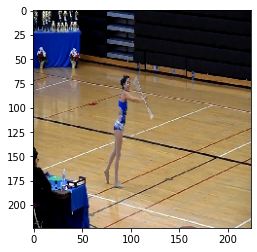

Dancing & its different forms


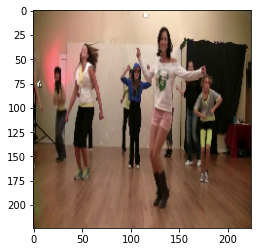

Dancing & its different forms


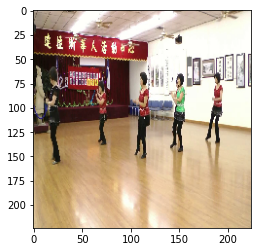

Couple dance (salsa)


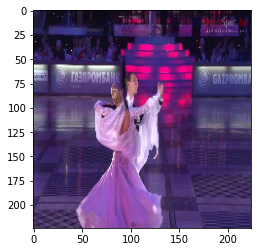

Couple dance (salsa)


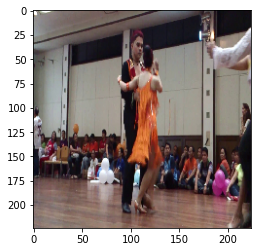

Couple dance (salsa)


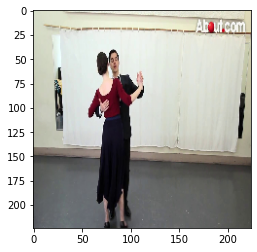

Couple dance (salsa)


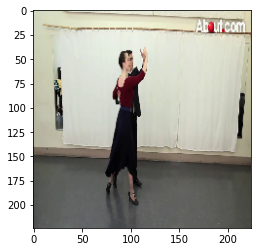

Couple dance (salsa)


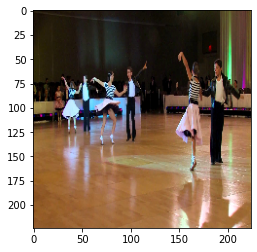

Couple dance (salsa)


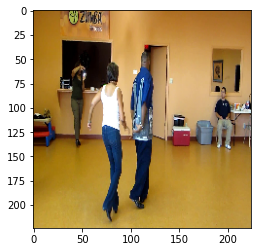

Couple dance (salsa)


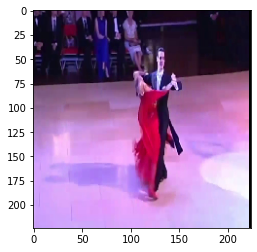

Couple dance (salsa)


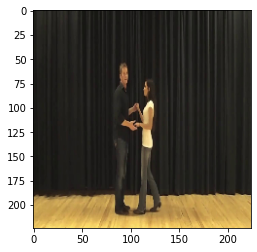

Couple dance (salsa)


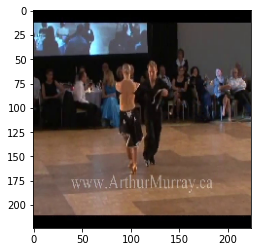

Couple dance (salsa)


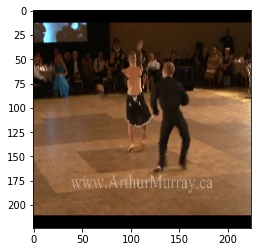

Couple dance (salsa)


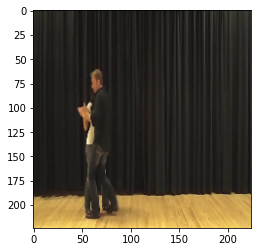

Couple dance (salsa)


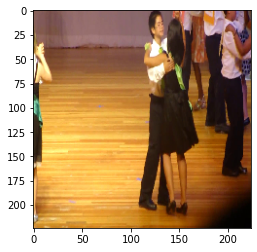

Couple dance (salsa)


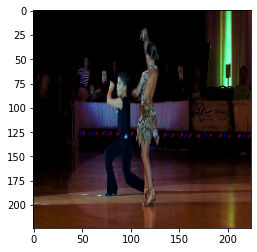

Couple dance (salsa)


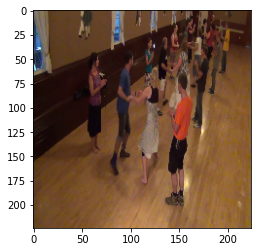

Dancing & its different forms


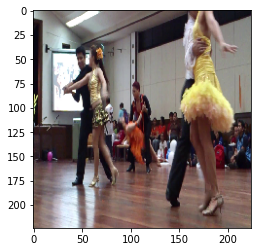

Couple dance (salsa)


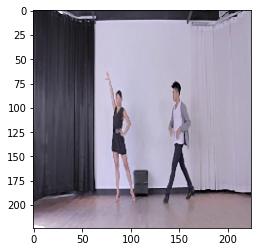

Couple dance (salsa)


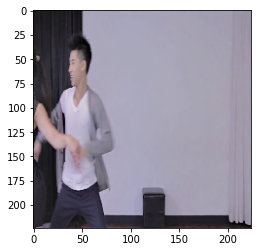

Couple dance (salsa)


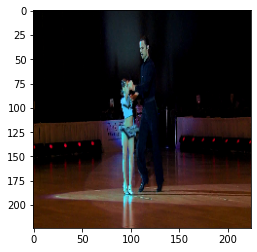

Couple dance (salsa)


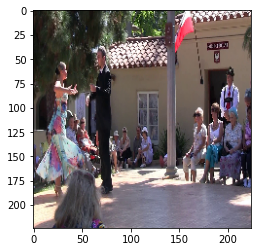

Couple dance (salsa)


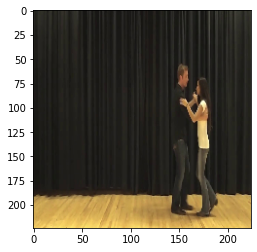

Couple dance (salsa)


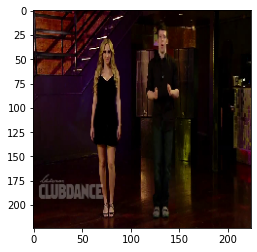

Couple dance (salsa)


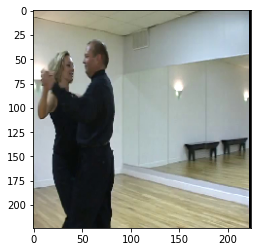

Couple dance (salsa)


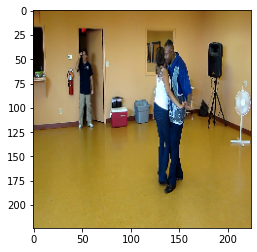

Couple dance (salsa)


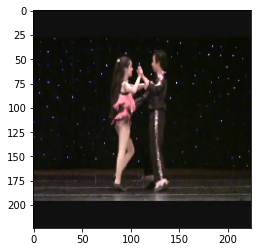

Couple dance (salsa)


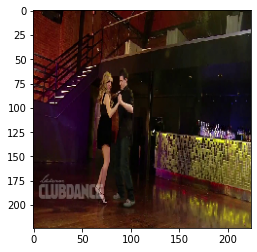

Couple dance (salsa)


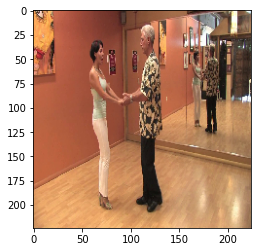

Couple dance (salsa)


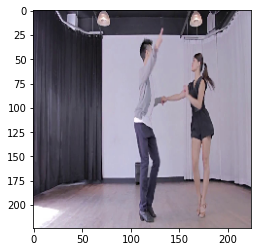

Couple dance (salsa)


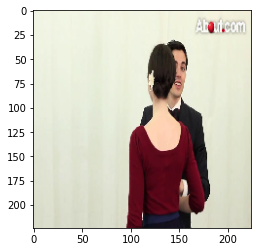

Couple dance (salsa)


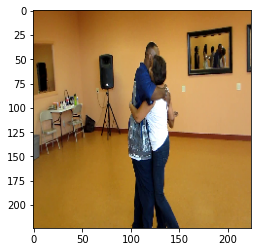

Couple dance (salsa)


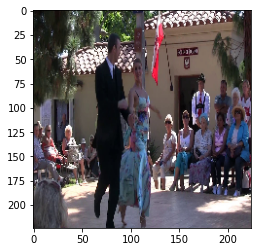

Couple dance (salsa)


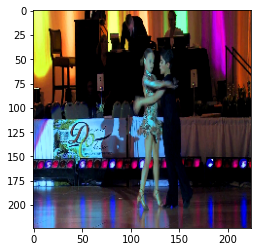

Couple dance (salsa)


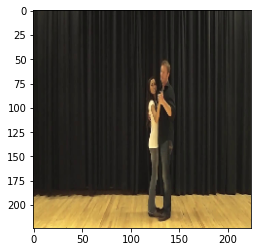

Couple dance (salsa)


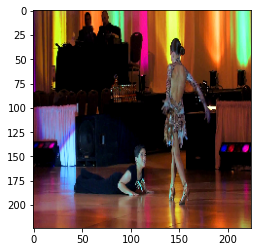

In [ ]:
from keras.preprocessing import image
import matplotlib.pyplot as plt
count=0
for ii in range(5):  #for first 5 batches
  x,y = validation_generator1[ii]
  for i in range(0,30):
      image = x[i]
      label = y[i]
      print(plabel[count])
      count+=1
      plt.imshow(image)
      plt.show()

### Xception50

In [ ]:
XModel_50 = load_model('/content/drive/MyDrive/DL/DL_Project_Data/Human_Pose_Models/Classification_Models/Xception_On50_Classes.h5')

In [ ]:
pred=XModel_50.predict_generator(validation_generator50_1)
predicted_class_indices=np.argmax(pred,axis=1)
labels = (validation_generator50_1.class_indices)
labels = dict((v,k) for k,v in labels.items())
predictions = [labels[k] for k in predicted_class_indices]
predictions 

# Image Joints Visualization

In [12]:
def imag(ix, df, pred=None):
    img = df['NAME'][ix]
    print(img)
    flag = 0
    path = ""
    for root, dirs, files in os.walk('/content/drive/MyDrive/DL/DL_Project_Data'):
      for file in files:
        if img == file:
          flag=1
          path = os.path.join(root, file)
          break
      if flag==1:
        break
    print(path)
    im = Image.open(path)
    print(im.size)
    implot = plt.imshow(im)
    
    try:
      i=0
      while i < pred.size:
          # col = df.columns[px]
          x = pred[i]
          i+=1
          # col = df.columns[px+1]
          y = pred[i]
          i+=1
          # print(col,x,y)
          plt.scatter([[x]],[[y]])
    
    except:
      px=2
      
      while px <34:
          col = df.columns[px]
          x = df[col][ix]
          col = df.columns[px+1]
          y = df[col][ix]
          print(col,x,y)
          plt.scatter([[x]],[[y]])
          px=px+2

## Regression Predictions

In [ ]:
for i in range(len(data)):
  if data['NAME'][i] == y_test[110]:
    print(i)
    break

13784


070913699.jpg
/content/drive/MyDrive/DL/DL_Project_Data/test_1/70/070913699.jpg
(1280, 720)
r ankle_Y -1 -1
r knee_Y -1 -1
r hip_Y 558 548
l hip_Y 645 548
l knee_Y -1 -1
l ankle_Y -1 -1
pelvis_Y 602 548
thorax_Y 604 227
upper neck_Y 607.0409 230.9976
head top_Y 511.9591 106.0024
r wrist_Y 486 400
r elbow_Y 449 350
r shoulder_Y 499 241
l shoulder_Y 708 213
l elbow_Y 808 339
l wrist_Y 727 370


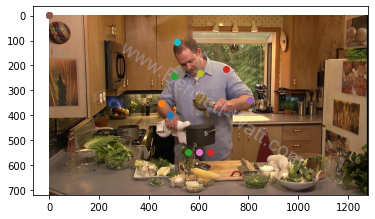

In [ ]:
imag(13784, data)

In [13]:
reg = load_model('/content/drive/MyDrive/DL/DL_Project_Data/Human_Pose_Models/Our Models/Regression_CNN.h5')

In [14]:
y_pred = reg.predict(X_test)

In [ ]:
data.loc[13784]

Unnamed: 0                                0
NAME                          070913699.jpg
r ankle_X                                -1
r ankle_Y                                -1
r knee_X                                 -1
r knee_Y                                 -1
r hip_X                                 558
r hip_Y                                 548
l hip_X                                 645
l hip_Y                                 548
l knee_X                                 -1
l knee_Y                                 -1
l ankle_X                                -1
l ankle_Y                                -1
pelvis_X                                602
pelvis_Y                                548
thorax_X                                604
thorax_Y                                227
upper neck_X                        607.041
upper neck_Y                        230.998
head top_X                          511.959
head top_Y                          106.002
r wrist_X                       

In [ ]:
y_pred[110]

array([ 41.55483 ,  54.065525, 105.00089 ,  88.73246 , 499.50137 ,
       476.29614 , 579.58954 , 477.6001  , 123.490105,  92.84182 ,
        49.868587,  53.302574, 538.4809  , 476.1671  , 573.82434 ,
       254.85982 , 573.9917  , 229.15388 , 580.61456 ,  97.100784,
       488.46036 , 406.26486 , 464.43048 , 375.952   , 497.25653 ,
       253.886   , 646.62024 , 255.43214 , 673.7534  , 380.9263  ,
       649.4187  , 415.32785 ], dtype=float32)

070913699.jpg
/content/drive/MyDrive/DL/DL_Project_Data/test_1/70/070913699.jpg
(1280, 720)


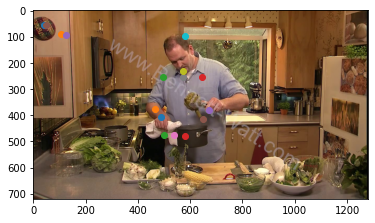

In [ ]:
imag(13784, data, y_pred[110]) # Model Predictions

## Regression Predictions

In [ ]:
for i in range(len(data)):
  if data['NAME'][i] == y_test[3]:
    print(i)
    break

9728


007748729.jpg
/content/drive/MyDrive/DL/DL_Project_Data/test_1/314/007748729.jpg
(1920, 1080)
r ankle_Y 639 850
r knee_Y 736 687
r hip_Y 803 542
l hip_Y 858 559
l knee_Y 904 679
l ankle_Y 887 831
pelvis_Y 831 551
thorax_Y 961 490
upper neck_Y 993.9408 490.1926
head top_Y 1099.0592 490.8074
r wrist_Y 743 549
r elbow_Y 820 477
r shoulder_Y 923 458
l shoulder_Y 998 521
l elbow_Y 967 648
l wrist_Y 988 749


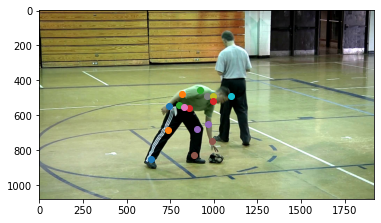

In [ ]:
imag(9728, data)

In [ ]:
# reg = load_model('/content/drive/MyDrive/DL/DL_Project_Data/Regression_Baseline.h5')
reg = load_model('/content/drive/MyDrive/DL/DL_Project_Data/Regression_ResNET50.h5')

In [ ]:
y_pred = reg.predict(X_test)

In [ ]:
data.loc[9728]

Unnamed: 0                      0
NAME                007748729.jpg
r ankle_X                     639
r ankle_Y                     850
r knee_X                      736
r knee_Y                      687
r hip_X                       803
r hip_Y                       542
l hip_X                       858
l hip_Y                       559
l knee_X                      904
l knee_Y                      679
l ankle_X                     887
l ankle_Y                     831
pelvis_X                      831
pelvis_Y                      551
thorax_X                      961
thorax_Y                      490
upper neck_X              993.941
upper neck_Y              490.193
head top_X                1099.06
head top_Y                490.807
r wrist_X                     743
r wrist_Y                     549
r elbow_X                     820
r elbow_Y                     477
r shoulder_X                  923
r shoulder_Y                  458
l shoulder_X                  998
l shoulder_Y  

In [ ]:
y_pred[3]

array([715.6407 , 705.9302 , 730.1621 , 612.73865, 737.3499 , 507.26306,
       778.2833 , 507.90967, 786.34705, 615.171  , 753.0304 , 705.12146,
       759.15137, 507.6089 , 759.39575, 338.74884, 759.67334, 320.99274,
       760.47516, 220.03264, 716.9262 , 459.0737 , 706.77844, 423.75815,
       723.78613, 338.4936 , 790.7067 , 339.23764, 802.5729 , 424.18118,
       796.1554 , 463.43497], dtype=float32)

007748729.jpg
/content/drive/MyDrive/DL/DL_Project_Data/test_1/314/007748729.jpg
(1920, 1080)


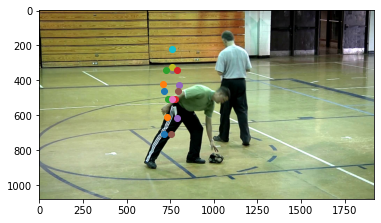

In [ ]:
imag(9728, data, y_pred[3]) # Model Predictions

In [ ]:
y_pred = resnet_model.predict(X_test)

007748729.jpg
/content/drive/MyDrive/DL/DL_Project_Data/test_1/314/007748729.jpg
(1920, 1080)


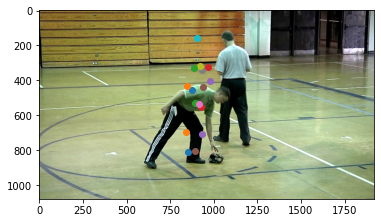

In [ ]:
imag(9728, data, y_pred[3])

## Random Images

In [16]:
def image_Scattering(im, pred):
    
    implot = plt.imshow(im)
    
    i=0
    while i < pred.size:
        
        x = pred[i]
        i+=1
        y = pred[i]
        i+=1
        
        plt.scatter([[np.max(x-200, 0)]],[[y]])

In [ ]:
# url = 'https://cdni0.trtworld.com/w960/h540/q75/31524_PRT180417PolandBialowiezaForestAFP_1523966626524.jpg'
# url = 'https://imgk.timesnownews.com/story/skipping-rope-new.gif?tr=w-1200,h-900'

In [35]:
# url = 'https://scuolasciarabba.com/files/.thumbs/adventure_skiing/640x960a/adventure_skiing_153.jpg'
# url = 'https://hips.hearstapps.com/hmg-prod.s3.amazonaws.com/images/cycle-rider-riding-hard-along-the-beach-royalty-free-image-1616705538.?crop=0.668xw:1.00xh;0.332xw,0&resize=640:*'
# url = 'https://c8.alamy.com/comp/XDT1YJ/boy-inline-skating-outdoors-XDT1YJ.jpg'

In [36]:
img = Image.open(requests.get(url, stream=True).raw)
print(type(img))

<class 'PIL.JpegImagePlugin.JpegImageFile'>


In [37]:
print(img.format)
print(img.size)
print(img.mode)

JPEG
(640, 639)
RGB


In [38]:
img1 = np.array(img)
img1 = cv2.resize(img1, (224, 224))
img1 = np.array(img1, ndmin=4)

In [39]:
predictions = reg.predict(img1)

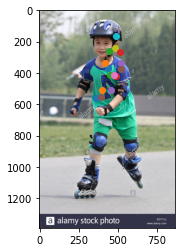

In [ ]:
image_Scattering(img, predictions[0])